# **Pre-trained VGG-19 model trained on the KDEF dataset with input image resolution of 112x112.**

In [1]:
!pip install tensorboardX

   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 101.7/101.7 kB 2.3 MB/s eta 0:00:00


In [2]:
import torch
import torch.nn as nn
import torch.optim as optim
from torch.optim import lr_scheduler
import numpy as np
import torchvision
from torchvision import datasets, models, transforms
import matplotlib.pyplot as plt
import time
from torch.utils.data import Dataset
import os
import copy
from tensorboardX import SummaryWriter
from PIL import Image
import torchvision.transforms as transforms
import random
plt.ion()   # interactive mode
%matplotlib inline

In [3]:
# Set fixed seed for reproducibility
seed = 42
random.seed(seed)
np.random.seed(seed)
torch.manual_seed(seed)
torch.cuda.manual_seed(seed)
torch.backends.cudnn.deterministic = True
torch.backends.cudnn.benchmark = False

In [4]:
from zipfile import ZipFile
import os

zip_path = '/content/KEDF_downsample_112x112.zip'

extract_to = '/content'

os.makedirs(extract_to, exist_ok=True)

with ZipFile(zip_path, 'r') as zip_ref:
    zip_ref.extractall(extract_to)

print(f'✅ Files extracted to: {extract_to}')

✅ Files extracted to: /content


In [5]:
import os

classes = {
    "AF": 0, "AN": 1, "DI": 2, "HA": 3, "NE": 4, "SA": 5, "SU": 6
}

root='/content/KEDF_downsample_112x112'
invalid_files = []

for path, subdirs, files in os.walk(root):
    for name in files:
        if len(name) >= 6:
            emotion_code = name[4:6]
            if emotion_code not in classes:
                invalid_files.append(os.path.join(path, name))

# Print the problematic files
print("Found {} problematic files:".format(len(invalid_files)))
for file in invalid_files:
    print(file)

Found 0 problematic files:


In [6]:
class KDEFDataset(Dataset):
    def __init__(self, root='/content/KEDF_downsample_112x112', transforms_=None, idx=[]):
        self.transform = transforms_
        self.files = []

        for path, subdirs, files in os.walk(root):
            for name in files:
                self.files.append(os.path.join(path, name))

        self.files =  [self.files[i] for i in idx]
        self.classes = {
             "AF":0,
             "AN":1,
             "DI":2,
             "HA":3,
             "NE":4,
             "SA":5,
             "SU":6
        }
        for f in self.files:
          name = f.split('/')[-1]
          emotion_code = name[4:6]
          if emotion_code not in self.classes:
              print(f"Invalid file: {f} (code: {emotion_code})")

        for index in range(4900):
            filepath = self.files[index % len(self.files)]
            filename = filepath.split('/')[-1]
            if filename[4:6] not in self.classes:
                print(filepath)

    def __getitem__(self, index):
        filepath = self.files[index % len(self.files)]

        filename = filepath.split('/')[-1]
        img = self.transform(Image.open(filepath))
        label = self.classes[filename[4:6]]

        return img, label

    def __len__(self):
        return len(self.files)

Load Data
---------


In [7]:
data_transforms = {
    'train': transforms.Compose([
        transforms.Resize(224),
        transforms.CenterCrop(224),
        transforms.RandomHorizontalFlip(),
        transforms.ToTensor(),
        transforms.Normalize([0.5, 0.5, 0.5], [0.5, 0.5, 0.5])
    ]),
    'val': transforms.Compose([
        transforms.Resize(224),
        transforms.CenterCrop(224),
        transforms.ToTensor(),
        transforms.Normalize([0.5, 0.5, 0.5], [0.5, 0.5, 0.5])
    ]),
}

idx = np.random.permutation(4900)
idx = {'val': idx[0:490], 'train': idx[490:]}

g = torch.Generator()
g.manual_seed(42)

dataloaders = {
    x: torch.utils.data.DataLoader(
        KDEFDataset(transforms_=data_transforms[x], idx=idx[x]),
        batch_size=32,
        shuffle=True,
        generator=g
    )
    for x in ['train', 'val']
}

dataset_sizes = {x: len(idx[x]) for x in ['train', 'val']}
class_names = 7

device = torch.device("cuda:0" if torch.cuda.is_available() else "cpu")

# Visualize a few images


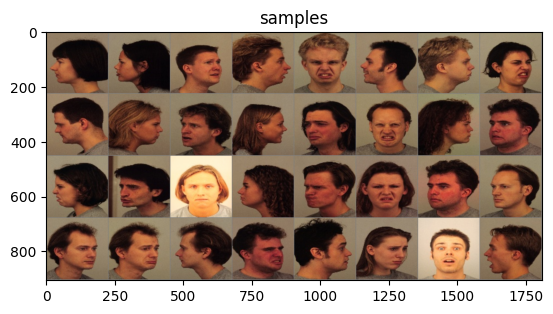

In [8]:
def imshow(inp, title=None):
    """Imshow for Tensor."""
    inp = inp.numpy().transpose((1, 2, 0))
    mean = np.array([0.5, 0.5, 0.5])
    std = np.array([0.5, 0.5, 0.5])
    inp = std * inp + mean
    inp = np.clip(inp, 0, 1)
    plt.imshow(inp)
    if title is not None:
        plt.title(title)
    plt.pause(0.001)  # pause a bit so that plots are updated


# Get a batch of training data
inputs, classes = next(iter(dataloaders['train']))

# Make a grid from batch
out = torchvision.utils.make_grid(inputs)

imshow(out, title='samples')

Training the model
------------------

Now, let's write a general function to train a model. Here, we will
illustrate:

-  Scheduling the learning rate
-  Saving the best model

In the following, parameter ``scheduler`` is an LR scheduler object from
``torch.optim.lr_scheduler``.



In [9]:
from tqdm import tqdm

def train_model(model, criterion, optimizer, scheduler, dataloaders, writer=None, i=0,  num_epochs=25):
    since = time.time()

    best_model_wts = copy.deepcopy(model.state_dict())
    best_acc = 0.0

    for epoch in range(num_epochs):
        print('Epoch {}/{}'.format(epoch, num_epochs - 1))
        print('-' * 10)

        # Each epoch has a training and validation phase
        for phase in ['train', 'val']:
            if phase == 'train':
                scheduler.step()
                model.train()  # Set model to training mode
            else:
                model.eval()   # Set model to evaluate mode

            running_loss = 0.0
            running_corrects = 0

            # Iterate over data.
            for inputs, labels in tqdm(dataloaders[phase]):
                inputs = inputs.to(device)
                labels = labels.to(device)

                # zero the parameter gradients
                optimizer.zero_grad()

                # forward
                # track history if only in train
                with torch.set_grad_enabled(phase == 'train'):
                    outputs = model(inputs)
                    _, preds = torch.max(outputs, 1)
                    loss = criterion(outputs, labels)

                    # backward + optimize only if in training phase
                    if phase == 'train':
                        loss.backward()
                        optimizer.step()

                # statistics
                running_loss += loss.item() * inputs.size(0)
                running_corrects += torch.sum(preds == labels.data)

            epoch_loss = running_loss / dataset_sizes[phase]
            epoch_acc = running_corrects.double() / dataset_sizes[phase]

            print('{} Loss: {:.4f} Acc: {:.4f}'.format(
                phase, epoch_loss, epoch_acc))


            writer.add_scalar(phase+"/loss", epoch_loss, epoch)
            writer.add_scalar(phase+"/acc", epoch_acc, epoch)


            # deep copy the model
            if phase == 'val' and epoch_acc > best_acc:
                best_acc = epoch_acc
                best_model_wts = copy.deepcopy(model.state_dict())

        print()


    time_elapsed = time.time() - since
    print('Training complete in {:.0f}m {:.0f}s'.format(
        time_elapsed // 60, time_elapsed % 60))
    print('Best val Acc: {:4f}'.format(best_acc))

    # load best model weights
    model.load_state_dict(best_model_wts)
    return model, best_acc

Visualizing the model predictions

In [10]:
import imageio
import os
import matplotlib.pyplot as plt
from PIL import Image, ImageDraw, ImageFont

def visualize_model_misclassified(model, dataloader, class_names, save_dir='misclassified', num_images=15, columns=3):
    os.makedirs(save_dir, exist_ok=True)
    was_training = model.training
    model.eval()
    images_so_far = 0
    rows = (num_images + columns - 1) // columns
    fig, axes = plt.subplots(rows, columns, figsize=(columns * 4, rows * 4))
    axes = axes.flatten()

    with torch.no_grad():
        for inputs, labels in dataloader:
            inputs = inputs.to(device)
            labels = labels.to(device)

            outputs = model(inputs)
            _, preds = torch.max(outputs, 1)

            for j in range(inputs.size()[0]):
                if preds[j] != labels[j]:
                    if images_so_far >= num_images:
                        break

                    # --- Display in grid ---
                    ax = axes[images_so_far]
                    ax.axis('off')
                    ax.set_title(f'Pred: {class_names[int(preds[j])]},\nTrue: {class_names[int(labels[j])]}', fontsize=9)
                    imshow(inputs.cpu().data[j], ax=ax)

                    # --- Save image with overlay text ---
                    img = inputs[j].cpu().numpy().transpose(1, 2, 0)
                    img = (img * 0.5 + 0.5) * 255
                    img = img.astype(np.uint8)
                    img_pil = Image.fromarray(img)

                    draw = ImageDraw.Draw(img_pil)
                    font = ImageFont.load_default()
                    text = f'Predicted: {class_names[int(preds[j])]} | True: {class_names[int(labels[j])]}'
                    draw.rectangle([10, 10, 280, 25], fill=(255, 255, 255))
                    draw.text((10, 10), text, font=font, fill=(0, 0, 0))

                    img_pil.save(f'{save_dir}/misclassified_{images_so_far + 1}.jpg')

                    images_so_far += 1

    for k in range(images_so_far, len(axes)):
        axes[k].axis('off')

    plt.tight_layout()
    plt.show()
    model.train(mode=was_training)


def imshow(inp, ax=None, title=None):
    inp = inp.numpy().transpose((1, 2, 0))
    mean = np.array([0.5, 0.5, 0.5])
    std = np.array([0.5, 0.5, 0.5])
    inp = std * inp + mean
    inp = np.clip(inp, 0, 1)
    if ax is None:
        plt.imshow(inp)
    else:
        ax.imshow(inp)
    if title is not None:
        ax.set_title(title)


Finetuning the convnet
----------------------

Load a pretrained model and reset final fully connected layer.




Downloading: "https://download.pytorch.org/models/vgg19-dcbb9e9d.pth" to /root/.cache/torch/hub/checkpoints/vgg19-dcbb9e9d.pth
100%|██████████| 548M/548M [00:03<00:00, 156MB/s]
/usr/local/lib/python3.11/dist-packages/torch/optim/lr_scheduler.py:227: UserWarning: Detected call of `lr_scheduler.step()` before `optimizer.step()`. In PyTorch 1.1.0 and later, you should call them in the opposite order: `optimizer.step()` before `lr_scheduler.step()`.  Failure to do this will result in PyTorch skipping the first value of the learning rate schedule. See more details at https://pytorch.org/docs/stable/optim.html#how-to-adjust-learning-rate
  warnings.warn(


Epoch 0/19
----------


100%|██████████| 138/138 [00:18<00:00,  7.35it/s]


train Loss: 1.7899 Acc: 0.2585


100%|██████████| 16/16 [00:01<00:00, 13.75it/s]


val Loss: 1.3726 Acc: 0.5041

Epoch 1/19
----------


100%|██████████| 138/138 [00:17<00:00,  8.12it/s]


train Loss: 1.1506 Acc: 0.5340


100%|██████████| 16/16 [00:01<00:00, 14.24it/s]


val Loss: 0.7896 Acc: 0.7000

Epoch 2/19
----------


100%|██████████| 138/138 [00:17<00:00,  8.11it/s]


train Loss: 0.7873 Acc: 0.6948


100%|██████████| 16/16 [00:01<00:00, 13.88it/s]


val Loss: 0.4887 Acc: 0.8306

Epoch 3/19
----------


100%|██████████| 138/138 [00:16<00:00,  8.18it/s]


train Loss: 0.5552 Acc: 0.7905


100%|██████████| 16/16 [00:01<00:00, 14.17it/s]


val Loss: 0.4169 Acc: 0.8490

Epoch 4/19
----------


100%|██████████| 138/138 [00:16<00:00,  8.16it/s]


train Loss: 0.4168 Acc: 0.8447


100%|██████████| 16/16 [00:01<00:00, 14.42it/s]


val Loss: 0.5343 Acc: 0.8041

Epoch 5/19
----------


100%|██████████| 138/138 [00:16<00:00,  8.17it/s]


train Loss: 0.2266 Acc: 0.9224


100%|██████████| 16/16 [00:01<00:00, 14.35it/s]


val Loss: 0.2585 Acc: 0.9102

Epoch 6/19
----------


100%|██████████| 138/138 [00:16<00:00,  8.19it/s]


train Loss: 0.1853 Acc: 0.9370


100%|██████████| 16/16 [00:01<00:00, 14.17it/s]


val Loss: 0.2453 Acc: 0.9143

Epoch 7/19
----------


100%|██████████| 138/138 [00:16<00:00,  8.15it/s]


train Loss: 0.1667 Acc: 0.9426


100%|██████████| 16/16 [00:01<00:00, 14.43it/s]


val Loss: 0.2551 Acc: 0.9082

Epoch 8/19
----------


100%|██████████| 138/138 [00:16<00:00,  8.16it/s]


train Loss: 0.1543 Acc: 0.9512


100%|██████████| 16/16 [00:01<00:00, 14.60it/s]


val Loss: 0.2357 Acc: 0.9204

Epoch 9/19
----------


100%|██████████| 138/138 [00:16<00:00,  8.18it/s]


train Loss: 0.1430 Acc: 0.9490


100%|██████████| 16/16 [00:01<00:00, 14.32it/s]


val Loss: 0.2314 Acc: 0.9245

Epoch 10/19
----------


100%|██████████| 138/138 [00:16<00:00,  8.17it/s]


train Loss: 0.1264 Acc: 0.9576


100%|██████████| 16/16 [00:01<00:00, 14.34it/s]


val Loss: 0.2561 Acc: 0.9082

Epoch 11/19
----------


100%|██████████| 138/138 [00:16<00:00,  8.14it/s]


train Loss: 0.1055 Acc: 0.9651


100%|██████████| 16/16 [00:01<00:00, 14.47it/s]


val Loss: 0.2314 Acc: 0.9204

Epoch 12/19
----------


100%|██████████| 138/138 [00:16<00:00,  8.16it/s]


train Loss: 0.1041 Acc: 0.9683


100%|██████████| 16/16 [00:01<00:00, 14.28it/s]


val Loss: 0.2323 Acc: 0.9184

Epoch 13/19
----------


100%|██████████| 138/138 [00:16<00:00,  8.12it/s]


train Loss: 0.1068 Acc: 0.9676


100%|██████████| 16/16 [00:01<00:00, 14.18it/s]


val Loss: 0.2334 Acc: 0.9224

Epoch 14/19
----------


100%|██████████| 138/138 [00:16<00:00,  8.15it/s]


train Loss: 0.1067 Acc: 0.9660


100%|██████████| 16/16 [00:01<00:00, 14.51it/s]


val Loss: 0.2349 Acc: 0.9204

Epoch 15/19
----------


100%|██████████| 138/138 [00:16<00:00,  8.18it/s]


train Loss: 0.1041 Acc: 0.9687


100%|██████████| 16/16 [00:01<00:00, 14.45it/s]


val Loss: 0.2313 Acc: 0.9224

Epoch 16/19
----------


100%|██████████| 138/138 [00:16<00:00,  8.12it/s]


train Loss: 0.0979 Acc: 0.9669


100%|██████████| 16/16 [00:01<00:00, 14.10it/s]


val Loss: 0.2309 Acc: 0.9204

Epoch 17/19
----------


100%|██████████| 138/138 [00:16<00:00,  8.16it/s]


train Loss: 0.0980 Acc: 0.9658


100%|██████████| 16/16 [00:01<00:00, 14.37it/s]


val Loss: 0.2310 Acc: 0.9184

Epoch 18/19
----------


100%|██████████| 138/138 [00:16<00:00,  8.20it/s]


train Loss: 0.0995 Acc: 0.9689


100%|██████████| 16/16 [00:01<00:00, 14.51it/s]


val Loss: 0.2312 Acc: 0.9204

Epoch 19/19
----------


100%|██████████| 138/138 [00:16<00:00,  8.18it/s]


train Loss: 0.0998 Acc: 0.9664


100%|██████████| 16/16 [00:01<00:00, 13.59it/s]


val Loss: 0.2315 Acc: 0.9204

Training complete in 6m 3s
Best val Acc: 0.924490
Showing misclassified examples for fold 0...


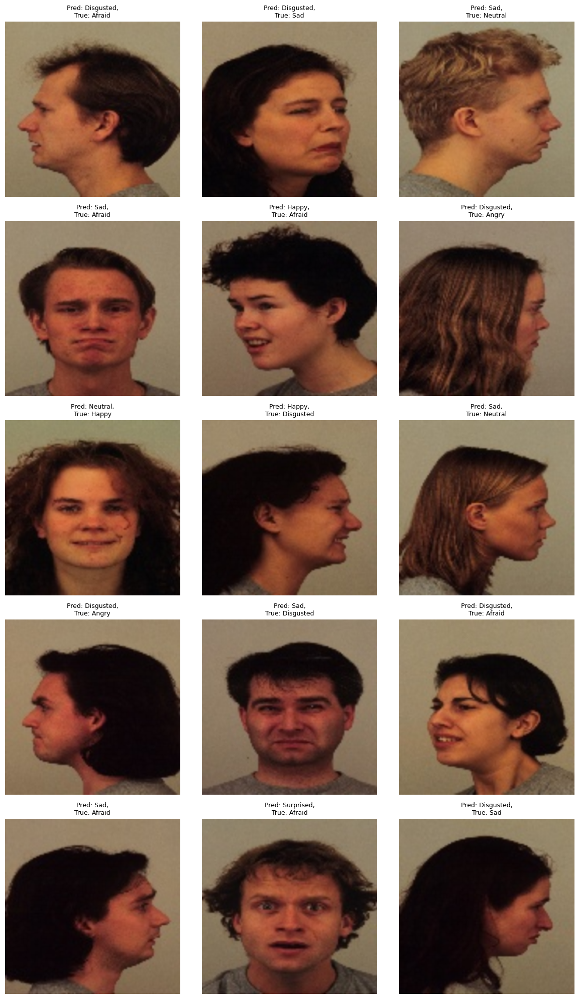




------------------------------------
 Accuracies  [0.9244897959183674]



Epoch 0/19
----------


100%|██████████| 138/138 [00:17<00:00,  7.97it/s]


train Loss: 1.7610 Acc: 0.2748


100%|██████████| 16/16 [00:01<00:00, 14.07it/s]


val Loss: 1.1740 Acc: 0.5429

Epoch 1/19
----------


100%|██████████| 138/138 [00:17<00:00,  8.01it/s]


train Loss: 1.0483 Acc: 0.5873


100%|██████████| 16/16 [00:01<00:00, 13.96it/s]


val Loss: 0.7848 Acc: 0.6918

Epoch 2/19
----------


100%|██████████| 138/138 [00:17<00:00,  7.98it/s]


train Loss: 0.6852 Acc: 0.7338


100%|██████████| 16/16 [00:01<00:00, 14.39it/s]


val Loss: 0.8122 Acc: 0.7061

Epoch 3/19
----------


100%|██████████| 138/138 [00:17<00:00,  7.96it/s]


train Loss: 0.5181 Acc: 0.8073


100%|██████████| 16/16 [00:01<00:00, 13.72it/s]


val Loss: 0.5245 Acc: 0.8204

Epoch 4/19
----------


100%|██████████| 138/138 [00:17<00:00,  8.01it/s]


train Loss: 0.4252 Acc: 0.8467


100%|██████████| 16/16 [00:01<00:00, 13.89it/s]


val Loss: 0.5314 Acc: 0.8061

Epoch 5/19
----------


100%|██████████| 138/138 [00:17<00:00,  7.99it/s]


train Loss: 0.2119 Acc: 0.9288


100%|██████████| 16/16 [00:01<00:00, 14.45it/s]


val Loss: 0.2947 Acc: 0.8980

Epoch 6/19
----------


100%|██████████| 138/138 [00:17<00:00,  7.99it/s]


train Loss: 0.1741 Acc: 0.9367


100%|██████████| 16/16 [00:01<00:00, 14.11it/s]


val Loss: 0.2902 Acc: 0.9041

Epoch 7/19
----------


100%|██████████| 138/138 [00:17<00:00,  7.93it/s]


train Loss: 0.1613 Acc: 0.9444


100%|██████████| 16/16 [00:01<00:00, 14.12it/s]


val Loss: 0.2907 Acc: 0.8959

Epoch 8/19
----------


100%|██████████| 138/138 [00:17<00:00,  8.02it/s]


train Loss: 0.1361 Acc: 0.9542


100%|██████████| 16/16 [00:01<00:00, 14.06it/s]


val Loss: 0.2960 Acc: 0.8939

Epoch 9/19
----------


100%|██████████| 138/138 [00:17<00:00,  8.05it/s]


train Loss: 0.1320 Acc: 0.9556


100%|██████████| 16/16 [00:01<00:00, 14.46it/s]


val Loss: 0.2761 Acc: 0.9041

Epoch 10/19
----------


100%|██████████| 138/138 [00:17<00:00,  8.02it/s]


train Loss: 0.1220 Acc: 0.9596


100%|██████████| 16/16 [00:01<00:00, 14.29it/s]


val Loss: 0.2700 Acc: 0.9041

Epoch 11/19
----------


100%|██████████| 138/138 [00:17<00:00,  8.03it/s]


train Loss: 0.0996 Acc: 0.9655


100%|██████████| 16/16 [00:01<00:00, 14.06it/s]


val Loss: 0.2690 Acc: 0.9000

Epoch 12/19
----------


100%|██████████| 138/138 [00:17<00:00,  8.00it/s]


train Loss: 0.1027 Acc: 0.9685


100%|██████████| 16/16 [00:01<00:00, 14.23it/s]


val Loss: 0.2693 Acc: 0.8980

Epoch 13/19
----------


100%|██████████| 138/138 [00:17<00:00,  7.98it/s]


train Loss: 0.1009 Acc: 0.9664


100%|██████████| 16/16 [00:01<00:00, 14.38it/s]


val Loss: 0.2702 Acc: 0.8959

Epoch 14/19
----------


100%|██████████| 138/138 [00:17<00:00,  7.98it/s]


train Loss: 0.1010 Acc: 0.9671


100%|██████████| 16/16 [00:01<00:00, 14.23it/s]


val Loss: 0.2679 Acc: 0.9000

Epoch 15/19
----------


100%|██████████| 138/138 [00:17<00:00,  8.02it/s]


train Loss: 0.0966 Acc: 0.9694


100%|██████████| 16/16 [00:01<00:00, 14.26it/s]


val Loss: 0.2659 Acc: 0.9020

Epoch 16/19
----------


100%|██████████| 138/138 [00:17<00:00,  8.03it/s]


train Loss: 0.0915 Acc: 0.9741


100%|██████████| 16/16 [00:01<00:00, 13.97it/s]


val Loss: 0.2677 Acc: 0.9041

Epoch 17/19
----------


100%|██████████| 138/138 [00:17<00:00,  8.02it/s]


train Loss: 0.0970 Acc: 0.9687


100%|██████████| 16/16 [00:01<00:00, 14.43it/s]


val Loss: 0.2673 Acc: 0.9041

Epoch 18/19
----------


100%|██████████| 138/138 [00:17<00:00,  7.94it/s]


train Loss: 0.0902 Acc: 0.9726


100%|██████████| 16/16 [00:01<00:00, 13.96it/s]


val Loss: 0.2671 Acc: 0.9020

Epoch 19/19
----------


100%|██████████| 138/138 [00:17<00:00,  8.01it/s]


train Loss: 0.0962 Acc: 0.9721


100%|██████████| 16/16 [00:01<00:00, 14.18it/s]


val Loss: 0.2671 Acc: 0.9020

Training complete in 6m 8s
Best val Acc: 0.904082
Showing misclassified examples for fold 1...


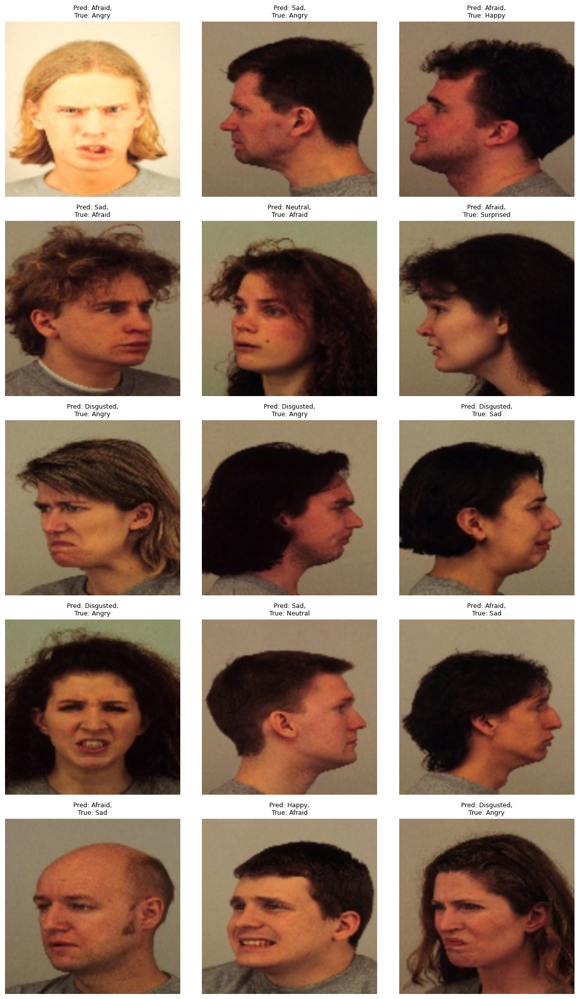




------------------------------------
 Accuracies  [0.9244897959183674, 0.9040816326530613]



Epoch 0/19
----------


100%|██████████| 138/138 [00:17<00:00,  7.93it/s]


train Loss: 1.7662 Acc: 0.2646


100%|██████████| 16/16 [00:01<00:00, 13.55it/s]


val Loss: 1.7261 Acc: 0.3490

Epoch 1/19
----------


100%|██████████| 138/138 [00:17<00:00,  7.92it/s]


train Loss: 1.1104 Acc: 0.5580


100%|██████████| 16/16 [00:01<00:00, 13.02it/s]


val Loss: 0.8971 Acc: 0.6796

Epoch 2/19
----------


100%|██████████| 138/138 [00:17<00:00,  7.80it/s]


train Loss: 0.7226 Acc: 0.7200


100%|██████████| 16/16 [00:01<00:00, 13.57it/s]


val Loss: 0.6009 Acc: 0.7755

Epoch 3/19
----------


100%|██████████| 138/138 [00:17<00:00,  7.88it/s]


train Loss: 0.5218 Acc: 0.8102


100%|██████████| 16/16 [00:01<00:00, 13.78it/s]


val Loss: 0.6397 Acc: 0.7694

Epoch 4/19
----------


100%|██████████| 138/138 [00:17<00:00,  7.89it/s]


train Loss: 0.3946 Acc: 0.8567


100%|██████████| 16/16 [00:01<00:00, 13.54it/s]


val Loss: 0.5671 Acc: 0.8143

Epoch 5/19
----------


100%|██████████| 138/138 [00:17<00:00,  7.96it/s]


train Loss: 0.2056 Acc: 0.9299


100%|██████████| 16/16 [00:01<00:00, 13.57it/s]


val Loss: 0.3793 Acc: 0.8816

Epoch 6/19
----------


100%|██████████| 138/138 [00:17<00:00,  7.98it/s]


train Loss: 0.1633 Acc: 0.9458


100%|██████████| 16/16 [00:01<00:00, 12.94it/s]


val Loss: 0.3669 Acc: 0.8796

Epoch 7/19
----------


100%|██████████| 138/138 [00:17<00:00,  7.91it/s]


train Loss: 0.1419 Acc: 0.9501


100%|██████████| 16/16 [00:01<00:00, 14.24it/s]


val Loss: 0.3667 Acc: 0.8959

Epoch 8/19
----------


100%|██████████| 138/138 [00:17<00:00,  7.83it/s]


train Loss: 0.1340 Acc: 0.9560


100%|██████████| 16/16 [00:01<00:00, 13.29it/s]


val Loss: 0.3659 Acc: 0.8918

Epoch 9/19
----------


100%|██████████| 138/138 [00:17<00:00,  7.83it/s]


train Loss: 0.1260 Acc: 0.9583


100%|██████████| 16/16 [00:01<00:00, 14.01it/s]


val Loss: 0.3410 Acc: 0.9020

Epoch 10/19
----------


100%|██████████| 138/138 [00:17<00:00,  7.89it/s]


train Loss: 0.1138 Acc: 0.9608


100%|██████████| 16/16 [00:01<00:00, 13.86it/s]


val Loss: 0.3522 Acc: 0.8898

Epoch 11/19
----------


100%|██████████| 138/138 [00:17<00:00,  7.89it/s]


train Loss: 0.0977 Acc: 0.9689


100%|██████████| 16/16 [00:01<00:00, 13.81it/s]


val Loss: 0.3504 Acc: 0.8898

Epoch 12/19
----------


100%|██████████| 138/138 [00:17<00:00,  7.89it/s]


train Loss: 0.0969 Acc: 0.9694


100%|██████████| 16/16 [00:01<00:00, 13.67it/s]


val Loss: 0.3545 Acc: 0.8898

Epoch 13/19
----------


100%|██████████| 138/138 [00:17<00:00,  7.94it/s]


train Loss: 0.0919 Acc: 0.9689


100%|██████████| 16/16 [00:01<00:00, 13.83it/s]


val Loss: 0.3529 Acc: 0.8939

Epoch 14/19
----------


100%|██████████| 138/138 [00:17<00:00,  7.82it/s]


train Loss: 0.0954 Acc: 0.9676


100%|██████████| 16/16 [00:01<00:00, 14.07it/s]


val Loss: 0.3538 Acc: 0.8959

Epoch 15/19
----------


100%|██████████| 138/138 [00:17<00:00,  7.79it/s]


train Loss: 0.0891 Acc: 0.9698


100%|██████████| 16/16 [00:01<00:00, 13.35it/s]


val Loss: 0.3600 Acc: 0.8959

Epoch 16/19
----------


100%|██████████| 138/138 [00:17<00:00,  7.81it/s]


train Loss: 0.0941 Acc: 0.9694


100%|██████████| 16/16 [00:01<00:00, 13.59it/s]


val Loss: 0.3518 Acc: 0.9020

Epoch 17/19
----------


100%|██████████| 138/138 [00:17<00:00,  7.84it/s]


train Loss: 0.0894 Acc: 0.9707


100%|██████████| 16/16 [00:01<00:00, 13.64it/s]


val Loss: 0.3514 Acc: 0.9020

Epoch 18/19
----------


100%|██████████| 138/138 [00:17<00:00,  7.81it/s]


train Loss: 0.0892 Acc: 0.9728


100%|██████████| 16/16 [00:01<00:00, 13.86it/s]


val Loss: 0.3520 Acc: 0.9020

Epoch 19/19
----------


100%|██████████| 138/138 [00:17<00:00,  7.82it/s]


train Loss: 0.0900 Acc: 0.9710


100%|██████████| 16/16 [00:01<00:00, 13.52it/s]


val Loss: 0.3520 Acc: 0.9020

Training complete in 6m 14s
Best val Acc: 0.902041
Showing misclassified examples for fold 2...


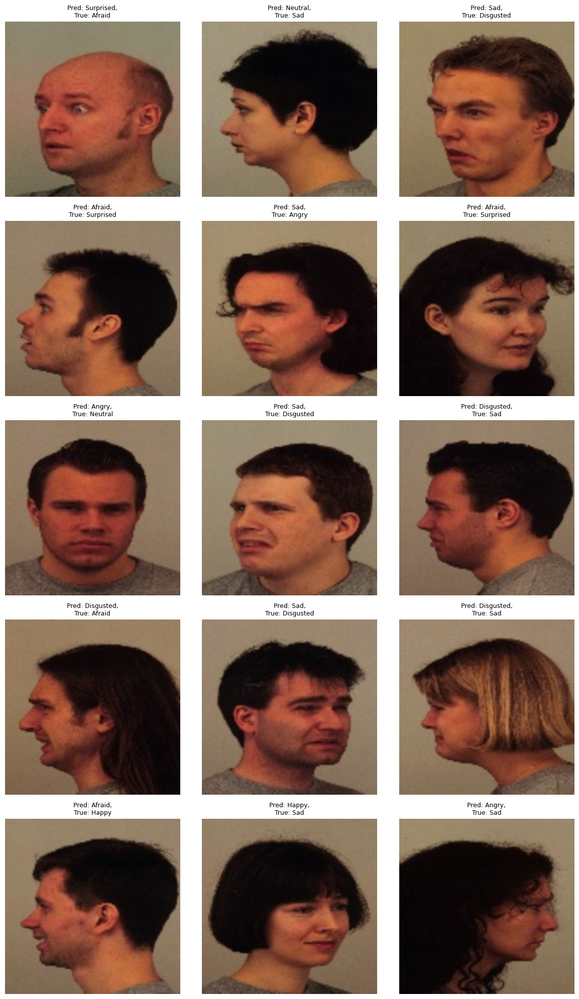




------------------------------------
 Accuracies  [0.9244897959183674, 0.9040816326530613, 0.9020408163265307]



Epoch 0/19
----------


100%|██████████| 138/138 [00:17<00:00,  7.84it/s]


train Loss: 1.7818 Acc: 0.2590


100%|██████████| 16/16 [00:01<00:00, 13.84it/s]


val Loss: 1.2960 Acc: 0.4816

Epoch 1/19
----------


100%|██████████| 138/138 [00:17<00:00,  7.82it/s]


train Loss: 1.1042 Acc: 0.5658


100%|██████████| 16/16 [00:01<00:00, 13.86it/s]


val Loss: 0.8078 Acc: 0.6878

Epoch 2/19
----------


100%|██████████| 138/138 [00:17<00:00,  7.88it/s]


train Loss: 0.7401 Acc: 0.7127


100%|██████████| 16/16 [00:01<00:00, 13.72it/s]


val Loss: 0.5684 Acc: 0.7918

Epoch 3/19
----------


100%|██████████| 138/138 [00:17<00:00,  7.91it/s]


train Loss: 0.5376 Acc: 0.8075


100%|██████████| 16/16 [00:01<00:00, 13.41it/s]


val Loss: 0.5596 Acc: 0.8061

Epoch 4/19
----------


100%|██████████| 138/138 [00:17<00:00,  7.92it/s]


train Loss: 0.4316 Acc: 0.8408


100%|██████████| 16/16 [00:01<00:00, 14.05it/s]


val Loss: 0.5289 Acc: 0.8041

Epoch 5/19
----------


100%|██████████| 138/138 [00:17<00:00,  7.85it/s]


train Loss: 0.2183 Acc: 0.9249


100%|██████████| 16/16 [00:01<00:00, 13.64it/s]


val Loss: 0.3172 Acc: 0.8776

Epoch 6/19
----------


100%|██████████| 138/138 [00:17<00:00,  7.87it/s]


train Loss: 0.1890 Acc: 0.9372


100%|██████████| 16/16 [00:01<00:00, 13.41it/s]


val Loss: 0.3113 Acc: 0.8755

Epoch 7/19
----------


100%|██████████| 138/138 [00:17<00:00,  7.95it/s]


train Loss: 0.1694 Acc: 0.9454


100%|██████████| 16/16 [00:01<00:00, 14.23it/s]


val Loss: 0.2983 Acc: 0.8959

Epoch 8/19
----------


100%|██████████| 138/138 [00:17<00:00,  7.80it/s]


train Loss: 0.1478 Acc: 0.9488


100%|██████████| 16/16 [00:01<00:00, 13.54it/s]


val Loss: 0.2855 Acc: 0.8939

Epoch 9/19
----------


100%|██████████| 138/138 [00:17<00:00,  7.87it/s]


train Loss: 0.1322 Acc: 0.9519


100%|██████████| 16/16 [00:01<00:00, 13.24it/s]


val Loss: 0.2700 Acc: 0.8898

Epoch 10/19
----------


100%|██████████| 138/138 [00:17<00:00,  7.88it/s]


train Loss: 0.1254 Acc: 0.9587


100%|██████████| 16/16 [00:01<00:00, 13.86it/s]


val Loss: 0.2827 Acc: 0.9020

Epoch 11/19
----------


100%|██████████| 138/138 [00:17<00:00,  7.94it/s]


train Loss: 0.1054 Acc: 0.9669


100%|██████████| 16/16 [00:01<00:00, 13.54it/s]


val Loss: 0.2670 Acc: 0.9000

Epoch 12/19
----------


100%|██████████| 138/138 [00:17<00:00,  7.87it/s]


train Loss: 0.1084 Acc: 0.9655


100%|██████████| 16/16 [00:01<00:00, 13.78it/s]


val Loss: 0.2636 Acc: 0.8959

Epoch 13/19
----------


100%|██████████| 138/138 [00:17<00:00,  7.96it/s]


train Loss: 0.1061 Acc: 0.9633


100%|██████████| 16/16 [00:01<00:00, 13.26it/s]


val Loss: 0.2637 Acc: 0.8959

Epoch 14/19
----------


100%|██████████| 138/138 [00:17<00:00,  7.90it/s]


train Loss: 0.0985 Acc: 0.9705


100%|██████████| 16/16 [00:01<00:00, 14.07it/s]


val Loss: 0.2718 Acc: 0.8918

Epoch 15/19
----------


100%|██████████| 138/138 [00:17<00:00,  7.84it/s]


train Loss: 0.0946 Acc: 0.9714


100%|██████████| 16/16 [00:01<00:00, 13.32it/s]


val Loss: 0.2655 Acc: 0.9000

Epoch 16/19
----------


100%|██████████| 138/138 [00:17<00:00,  7.93it/s]


train Loss: 0.0982 Acc: 0.9689


100%|██████████| 16/16 [00:01<00:00, 14.01it/s]


val Loss: 0.2614 Acc: 0.9020

Epoch 17/19
----------


100%|██████████| 138/138 [00:17<00:00,  7.85it/s]


train Loss: 0.0955 Acc: 0.9726


100%|██████████| 16/16 [00:01<00:00, 13.66it/s]


val Loss: 0.2621 Acc: 0.9020

Epoch 18/19
----------


100%|██████████| 138/138 [00:17<00:00,  7.89it/s]


train Loss: 0.0957 Acc: 0.9687


100%|██████████| 16/16 [00:01<00:00, 13.22it/s]


val Loss: 0.2627 Acc: 0.9020

Epoch 19/19
----------


100%|██████████| 138/138 [00:17<00:00,  7.92it/s]


train Loss: 0.0935 Acc: 0.9707


100%|██████████| 16/16 [00:01<00:00, 14.13it/s]


val Loss: 0.2621 Acc: 0.9020

Training complete in 6m 14s
Best val Acc: 0.902041
Showing misclassified examples for fold 3...


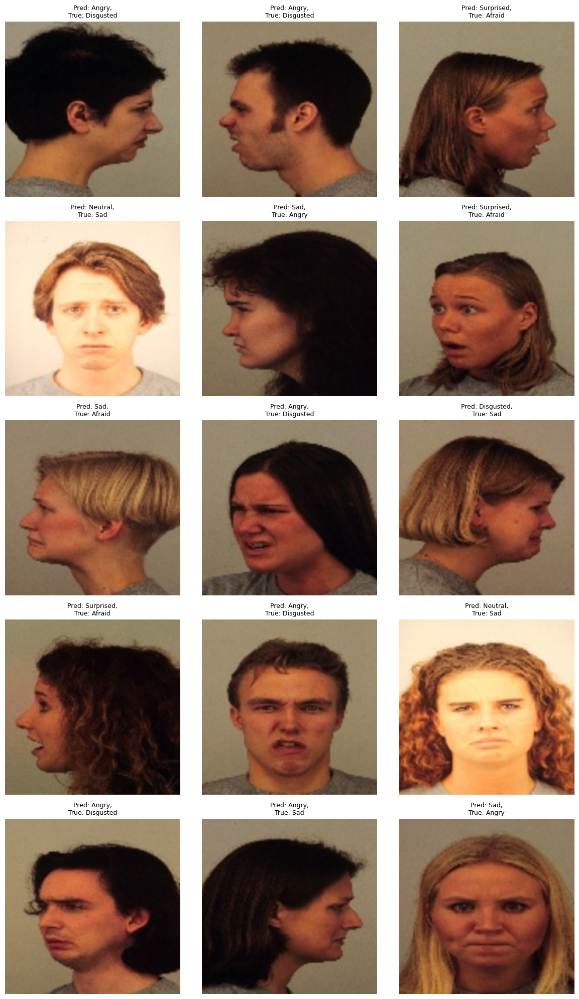




------------------------------------
 Accuracies  [0.9244897959183674, 0.9040816326530613, 0.9020408163265307, 0.9020408163265307]



Epoch 0/19
----------


100%|██████████| 138/138 [00:17<00:00,  7.93it/s]


train Loss: 1.8086 Acc: 0.2460


100%|██████████| 16/16 [00:01<00:00, 13.97it/s]


val Loss: 1.4338 Acc: 0.4531

Epoch 1/19
----------


100%|██████████| 138/138 [00:17<00:00,  7.95it/s]


train Loss: 1.1850 Acc: 0.5272


100%|██████████| 16/16 [00:01<00:00, 13.53it/s]


val Loss: 0.9245 Acc: 0.6449

Epoch 2/19
----------


100%|██████████| 138/138 [00:17<00:00,  8.00it/s]


train Loss: 0.7422 Acc: 0.7224


100%|██████████| 16/16 [00:01<00:00, 14.18it/s]


val Loss: 0.6427 Acc: 0.7449

Epoch 3/19
----------


100%|██████████| 138/138 [00:17<00:00,  7.85it/s]


train Loss: 0.5489 Acc: 0.7941


100%|██████████| 16/16 [00:01<00:00, 14.03it/s]


val Loss: 0.5913 Acc: 0.7714

Epoch 4/19
----------


100%|██████████| 138/138 [00:17<00:00,  7.95it/s]


train Loss: 0.4278 Acc: 0.8458


100%|██████████| 16/16 [00:01<00:00, 13.95it/s]


val Loss: 0.4294 Acc: 0.8388

Epoch 5/19
----------


100%|██████████| 138/138 [00:17<00:00,  7.92it/s]


train Loss: 0.2375 Acc: 0.9179


100%|██████████| 16/16 [00:01<00:00, 13.94it/s]


val Loss: 0.3077 Acc: 0.8980

Epoch 6/19
----------


100%|██████████| 138/138 [00:17<00:00,  8.01it/s]


train Loss: 0.1916 Acc: 0.9347


100%|██████████| 16/16 [00:01<00:00, 13.72it/s]


val Loss: 0.2883 Acc: 0.9000

Epoch 7/19
----------


100%|██████████| 138/138 [00:17<00:00,  7.97it/s]


train Loss: 0.1683 Acc: 0.9454


100%|██████████| 16/16 [00:01<00:00, 13.60it/s]


val Loss: 0.2734 Acc: 0.9143

Epoch 8/19
----------


100%|██████████| 138/138 [00:17<00:00,  7.89it/s]


train Loss: 0.1557 Acc: 0.9483


100%|██████████| 16/16 [00:01<00:00, 13.44it/s]


val Loss: 0.2705 Acc: 0.9204

Epoch 9/19
----------


100%|██████████| 138/138 [00:17<00:00,  7.95it/s]


train Loss: 0.1376 Acc: 0.9553


100%|██████████| 16/16 [00:01<00:00, 13.15it/s]


val Loss: 0.2602 Acc: 0.9184

Epoch 10/19
----------


100%|██████████| 138/138 [00:17<00:00,  7.95it/s]


train Loss: 0.1308 Acc: 0.9569


100%|██████████| 16/16 [00:01<00:00, 14.07it/s]


val Loss: 0.2539 Acc: 0.9204

Epoch 11/19
----------


100%|██████████| 138/138 [00:17<00:00,  7.93it/s]


train Loss: 0.1107 Acc: 0.9655


100%|██████████| 16/16 [00:01<00:00, 13.56it/s]


val Loss: 0.2509 Acc: 0.9245

Epoch 12/19
----------


100%|██████████| 138/138 [00:17<00:00,  7.97it/s]


train Loss: 0.1087 Acc: 0.9667


100%|██████████| 16/16 [00:01<00:00, 13.44it/s]


val Loss: 0.2491 Acc: 0.9184

Epoch 13/19
----------


100%|██████████| 138/138 [00:17<00:00,  7.92it/s]


train Loss: 0.1076 Acc: 0.9667


100%|██████████| 16/16 [00:01<00:00, 14.11it/s]


val Loss: 0.2481 Acc: 0.9204

Epoch 14/19
----------


100%|██████████| 138/138 [00:17<00:00,  7.89it/s]


train Loss: 0.1084 Acc: 0.9649


100%|██████████| 16/16 [00:01<00:00, 13.93it/s]


val Loss: 0.2474 Acc: 0.9224

Epoch 15/19
----------


100%|██████████| 138/138 [00:17<00:00,  7.94it/s]


train Loss: 0.1054 Acc: 0.9680


100%|██████████| 16/16 [00:01<00:00, 13.78it/s]


val Loss: 0.2498 Acc: 0.9224

Epoch 16/19
----------


100%|██████████| 138/138 [00:17<00:00,  7.89it/s]


train Loss: 0.1038 Acc: 0.9673


100%|██████████| 16/16 [00:01<00:00, 13.64it/s]


val Loss: 0.2504 Acc: 0.9245

Epoch 17/19
----------


100%|██████████| 138/138 [00:17<00:00,  7.87it/s]


train Loss: 0.1038 Acc: 0.9676


100%|██████████| 16/16 [00:01<00:00, 13.66it/s]


val Loss: 0.2497 Acc: 0.9224

Epoch 18/19
----------


100%|██████████| 138/138 [00:17<00:00,  7.96it/s]


train Loss: 0.1007 Acc: 0.9694


100%|██████████| 16/16 [00:01<00:00, 14.34it/s]


val Loss: 0.2489 Acc: 0.9224

Epoch 19/19
----------


100%|██████████| 138/138 [00:17<00:00,  7.93it/s]


train Loss: 0.1031 Acc: 0.9669


100%|██████████| 16/16 [00:01<00:00, 13.87it/s]


val Loss: 0.2487 Acc: 0.9224

Training complete in 6m 11s
Best val Acc: 0.924490
Showing misclassified examples for fold 4...


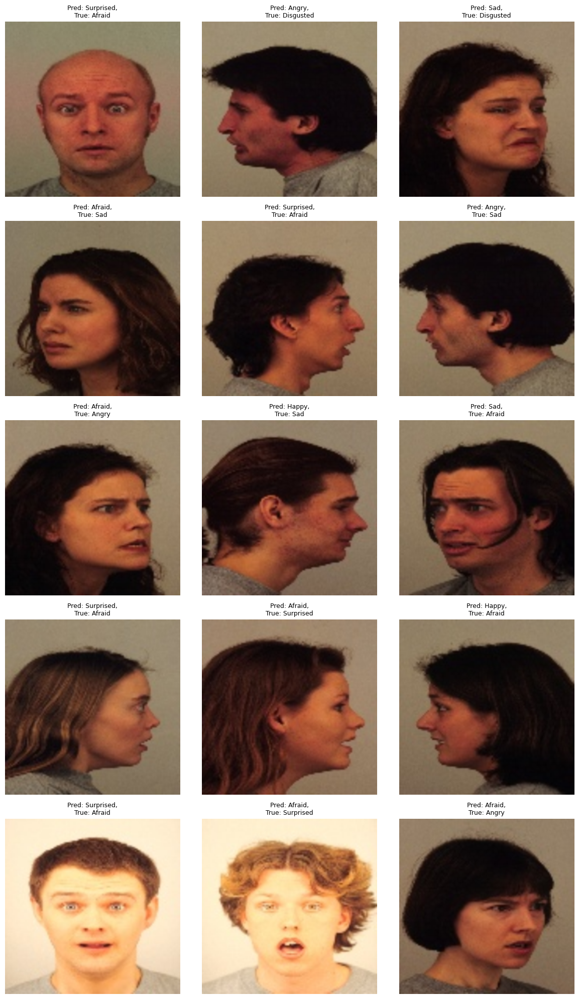




------------------------------------
 Accuracies  [0.9244897959183674, 0.9040816326530613, 0.9020408163265307, 0.9020408163265307, 0.9244897959183674]



Epoch 0/19
----------


100%|██████████| 138/138 [00:17<00:00,  7.94it/s]


train Loss: 1.7472 Acc: 0.2780


100%|██████████| 16/16 [00:01<00:00, 14.08it/s]


val Loss: 1.3162 Acc: 0.4735

Epoch 1/19
----------


100%|██████████| 138/138 [00:17<00:00,  7.97it/s]


train Loss: 1.0745 Acc: 0.5823


100%|██████████| 16/16 [00:01<00:00, 13.49it/s]


val Loss: 0.8525 Acc: 0.6673

Epoch 2/19
----------


100%|██████████| 138/138 [00:17<00:00,  7.91it/s]


train Loss: 0.6707 Acc: 0.7460


100%|██████████| 16/16 [00:01<00:00, 11.38it/s]


val Loss: 0.6859 Acc: 0.7265

Epoch 3/19
----------


100%|██████████| 138/138 [00:17<00:00,  7.87it/s]


train Loss: 0.5023 Acc: 0.8177


100%|██████████| 16/16 [00:01<00:00, 13.78it/s]


val Loss: 0.4658 Acc: 0.8265

Epoch 4/19
----------


100%|██████████| 138/138 [00:17<00:00,  8.00it/s]


train Loss: 0.3833 Acc: 0.8639


100%|██████████| 16/16 [00:01<00:00, 13.99it/s]


val Loss: 0.4551 Acc: 0.8224

Epoch 5/19
----------


100%|██████████| 138/138 [00:17<00:00,  7.96it/s]


train Loss: 0.2055 Acc: 0.9320


100%|██████████| 16/16 [00:01<00:00, 13.71it/s]


val Loss: 0.3041 Acc: 0.8816

Epoch 6/19
----------


100%|██████████| 138/138 [00:17<00:00,  7.99it/s]


train Loss: 0.1604 Acc: 0.9431


100%|██████████| 16/16 [00:01<00:00, 13.06it/s]


val Loss: 0.2982 Acc: 0.8939

Epoch 7/19
----------


100%|██████████| 138/138 [00:17<00:00,  7.85it/s]


train Loss: 0.1515 Acc: 0.9499


100%|██████████| 16/16 [00:01<00:00, 12.94it/s]


val Loss: 0.2790 Acc: 0.8857

Epoch 8/19
----------


100%|██████████| 138/138 [00:17<00:00,  7.99it/s]


train Loss: 0.1350 Acc: 0.9544


100%|██████████| 16/16 [00:01<00:00, 14.20it/s]


val Loss: 0.2700 Acc: 0.8918

Epoch 9/19
----------


100%|██████████| 138/138 [00:17<00:00,  7.97it/s]


train Loss: 0.1199 Acc: 0.9608


100%|██████████| 16/16 [00:01<00:00, 14.10it/s]


val Loss: 0.2532 Acc: 0.9020

Epoch 10/19
----------


100%|██████████| 138/138 [00:17<00:00,  7.99it/s]


train Loss: 0.1068 Acc: 0.9662


100%|██████████| 16/16 [00:01<00:00, 14.03it/s]


val Loss: 0.2729 Acc: 0.8980

Epoch 11/19
----------


100%|██████████| 138/138 [00:17<00:00,  7.92it/s]


train Loss: 0.0973 Acc: 0.9673


100%|██████████| 16/16 [00:01<00:00, 14.00it/s]


val Loss: 0.2478 Acc: 0.9122

Epoch 12/19
----------


100%|██████████| 138/138 [00:17<00:00,  7.95it/s]


train Loss: 0.0931 Acc: 0.9701


100%|██████████| 16/16 [00:01<00:00, 13.34it/s]


val Loss: 0.2493 Acc: 0.9122

Epoch 13/19
----------


100%|██████████| 138/138 [00:17<00:00,  7.94it/s]


train Loss: 0.0886 Acc: 0.9707


100%|██████████| 16/16 [00:01<00:00, 14.04it/s]


val Loss: 0.2514 Acc: 0.9122

Epoch 14/19
----------


100%|██████████| 138/138 [00:17<00:00,  7.95it/s]


train Loss: 0.0927 Acc: 0.9717


100%|██████████| 16/16 [00:01<00:00, 14.11it/s]


val Loss: 0.2461 Acc: 0.9000

Epoch 15/19
----------


100%|██████████| 138/138 [00:17<00:00,  7.94it/s]


train Loss: 0.0884 Acc: 0.9712


100%|██████████| 16/16 [00:01<00:00, 13.86it/s]


val Loss: 0.2496 Acc: 0.9102

Epoch 16/19
----------


100%|██████████| 138/138 [00:17<00:00,  7.99it/s]


train Loss: 0.0905 Acc: 0.9730


100%|██████████| 16/16 [00:01<00:00, 12.81it/s]


val Loss: 0.2481 Acc: 0.9102

Epoch 17/19
----------


100%|██████████| 138/138 [00:17<00:00,  7.95it/s]


train Loss: 0.0869 Acc: 0.9723


100%|██████████| 16/16 [00:01<00:00, 13.36it/s]


val Loss: 0.2475 Acc: 0.9082

Epoch 18/19
----------


100%|██████████| 138/138 [00:17<00:00,  7.97it/s]


train Loss: 0.0857 Acc: 0.9723


100%|██████████| 16/16 [00:01<00:00, 14.02it/s]


val Loss: 0.2476 Acc: 0.9102

Epoch 19/19
----------


100%|██████████| 138/138 [00:17<00:00,  7.85it/s]


train Loss: 0.0860 Acc: 0.9721


100%|██████████| 16/16 [00:01<00:00, 13.05it/s]


val Loss: 0.2474 Acc: 0.9082

Training complete in 6m 11s
Best val Acc: 0.912245
Showing misclassified examples for fold 5...


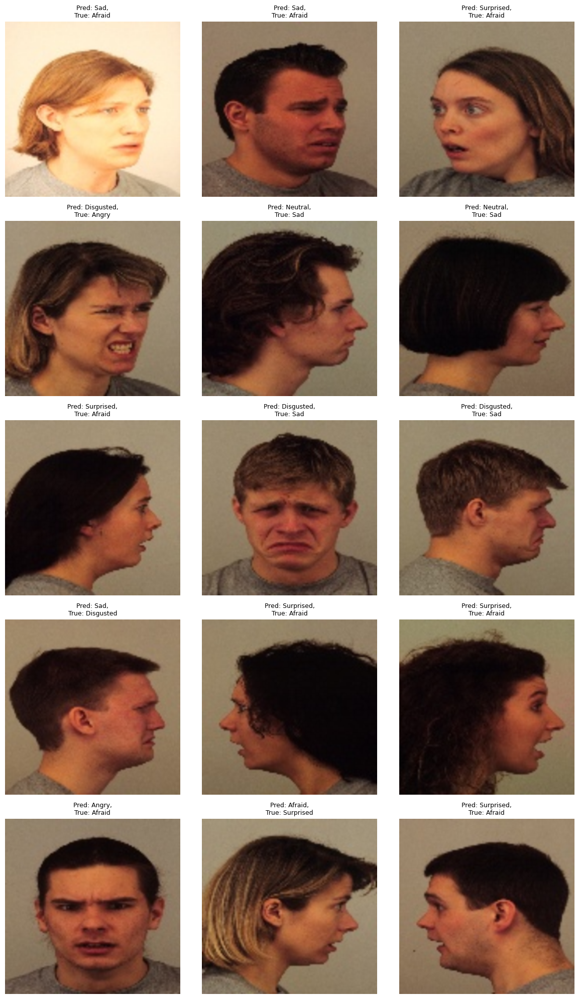




------------------------------------
 Accuracies  [0.9244897959183674, 0.9040816326530613, 0.9020408163265307, 0.9020408163265307, 0.9244897959183674, 0.9122448979591837]



Epoch 0/19
----------


100%|██████████| 138/138 [00:17<00:00,  7.93it/s]


train Loss: 1.7864 Acc: 0.2639


100%|██████████| 16/16 [00:01<00:00, 13.91it/s]


val Loss: 1.4232 Acc: 0.4347

Epoch 1/19
----------


100%|██████████| 138/138 [00:17<00:00,  8.04it/s]


train Loss: 1.1147 Acc: 0.5526


100%|██████████| 16/16 [00:01<00:00, 12.94it/s]


val Loss: 0.8006 Acc: 0.7286

Epoch 2/19
----------


100%|██████████| 138/138 [00:17<00:00,  8.05it/s]


train Loss: 0.7366 Acc: 0.7086


100%|██████████| 16/16 [00:01<00:00, 13.78it/s]


val Loss: 0.6590 Acc: 0.7408

Epoch 3/19
----------


100%|██████████| 138/138 [00:17<00:00,  7.98it/s]


train Loss: 0.5461 Acc: 0.7964


100%|██████████| 16/16 [00:01<00:00, 14.08it/s]


val Loss: 0.5604 Acc: 0.7878

Epoch 4/19
----------


100%|██████████| 138/138 [00:17<00:00,  8.01it/s]


train Loss: 0.4092 Acc: 0.8499


100%|██████████| 16/16 [00:01<00:00, 13.99it/s]


val Loss: 0.4231 Acc: 0.8673

Epoch 5/19
----------


100%|██████████| 138/138 [00:17<00:00,  7.95it/s]


train Loss: 0.2136 Acc: 0.9245


100%|██████████| 16/16 [00:01<00:00, 13.48it/s]


val Loss: 0.3084 Acc: 0.9061

Epoch 6/19
----------


100%|██████████| 138/138 [00:17<00:00,  7.97it/s]


train Loss: 0.1756 Acc: 0.9383


100%|██████████| 16/16 [00:01<00:00, 13.50it/s]


val Loss: 0.3067 Acc: 0.8959

Epoch 7/19
----------


100%|██████████| 138/138 [00:17<00:00,  8.02it/s]


train Loss: 0.1626 Acc: 0.9497


100%|██████████| 16/16 [00:01<00:00, 13.81it/s]


val Loss: 0.2851 Acc: 0.8980

Epoch 8/19
----------


100%|██████████| 138/138 [00:17<00:00,  8.00it/s]


train Loss: 0.1477 Acc: 0.9494


100%|██████████| 16/16 [00:01<00:00, 14.18it/s]


val Loss: 0.2755 Acc: 0.9000

Epoch 9/19
----------


100%|██████████| 138/138 [00:17<00:00,  8.06it/s]


train Loss: 0.1333 Acc: 0.9569


100%|██████████| 16/16 [00:01<00:00, 13.82it/s]


val Loss: 0.2765 Acc: 0.9143

Epoch 10/19
----------


100%|██████████| 138/138 [00:17<00:00,  8.01it/s]


train Loss: 0.1256 Acc: 0.9610


100%|██████████| 16/16 [00:01<00:00, 13.76it/s]


val Loss: 0.2664 Acc: 0.9122

Epoch 11/19
----------


100%|██████████| 138/138 [00:17<00:00,  7.96it/s]


train Loss: 0.1012 Acc: 0.9680


100%|██████████| 16/16 [00:01<00:00, 14.00it/s]


val Loss: 0.2570 Acc: 0.9082

Epoch 12/19
----------


100%|██████████| 138/138 [00:17<00:00,  7.97it/s]


train Loss: 0.1059 Acc: 0.9655


100%|██████████| 16/16 [00:01<00:00, 14.14it/s]


val Loss: 0.2576 Acc: 0.9122

Epoch 13/19
----------


100%|██████████| 138/138 [00:17<00:00,  7.99it/s]


train Loss: 0.1038 Acc: 0.9664


100%|██████████| 16/16 [00:01<00:00, 14.15it/s]


val Loss: 0.2555 Acc: 0.9163

Epoch 14/19
----------


100%|██████████| 138/138 [00:17<00:00,  7.96it/s]


train Loss: 0.0966 Acc: 0.9692


100%|██████████| 16/16 [00:01<00:00, 12.69it/s]


val Loss: 0.2590 Acc: 0.9143

Epoch 15/19
----------


100%|██████████| 138/138 [00:17<00:00,  8.01it/s]


train Loss: 0.0970 Acc: 0.9694


100%|██████████| 16/16 [00:01<00:00, 13.87it/s]


val Loss: 0.2589 Acc: 0.9102

Epoch 16/19
----------


100%|██████████| 138/138 [00:17<00:00,  7.94it/s]


train Loss: 0.1002 Acc: 0.9687


100%|██████████| 16/16 [00:01<00:00, 13.90it/s]


val Loss: 0.2573 Acc: 0.9143

Epoch 17/19
----------


100%|██████████| 138/138 [00:17<00:00,  7.98it/s]


train Loss: 0.1010 Acc: 0.9685


100%|██████████| 16/16 [00:01<00:00, 13.74it/s]


val Loss: 0.2574 Acc: 0.9122

Epoch 18/19
----------


100%|██████████| 138/138 [00:17<00:00,  8.03it/s]


train Loss: 0.0941 Acc: 0.9719


100%|██████████| 16/16 [00:01<00:00, 13.31it/s]


val Loss: 0.2576 Acc: 0.9122

Epoch 19/19
----------


100%|██████████| 138/138 [00:17<00:00,  7.97it/s]


train Loss: 0.0932 Acc: 0.9687


100%|██████████| 16/16 [00:01<00:00, 13.69it/s]


val Loss: 0.2576 Acc: 0.9143

Training complete in 6m 9s
Best val Acc: 0.916327
Showing misclassified examples for fold 6...


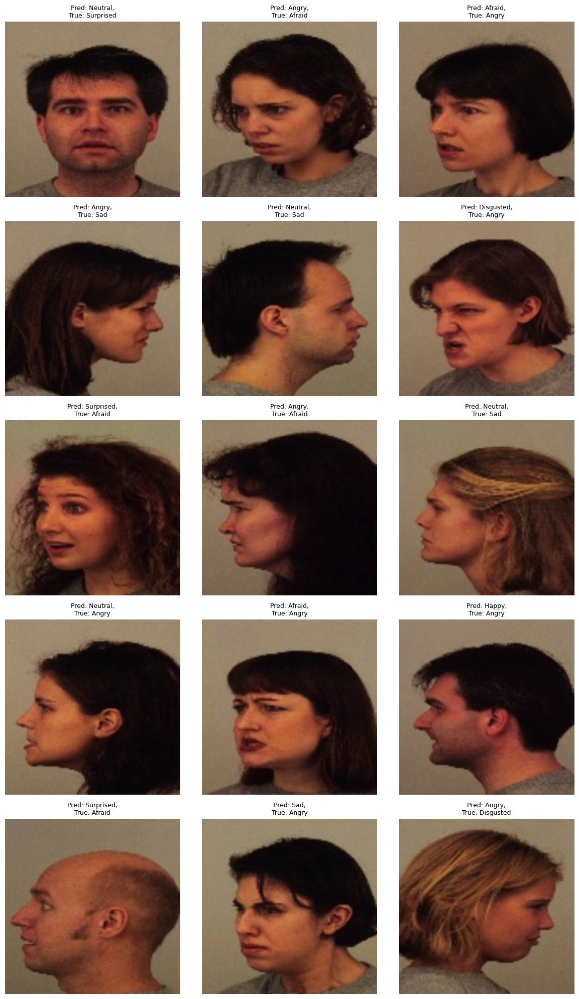




------------------------------------
 Accuracies  [0.9244897959183674, 0.9040816326530613, 0.9020408163265307, 0.9020408163265307, 0.9244897959183674, 0.9122448979591837, 0.916326530612245]



Epoch 0/19
----------


100%|██████████| 138/138 [00:17<00:00,  7.97it/s]


train Loss: 1.7976 Acc: 0.2447


100%|██████████| 16/16 [00:01<00:00, 14.16it/s]


val Loss: 1.3971 Acc: 0.3980

Epoch 1/19
----------


100%|██████████| 138/138 [00:17<00:00,  7.90it/s]


train Loss: 1.0985 Acc: 0.5739


100%|██████████| 16/16 [00:01<00:00, 14.30it/s]


val Loss: 0.7825 Acc: 0.6735

Epoch 2/19
----------


100%|██████████| 138/138 [00:17<00:00,  7.96it/s]


train Loss: 0.7302 Acc: 0.7224


100%|██████████| 16/16 [00:01<00:00, 13.96it/s]


val Loss: 0.6056 Acc: 0.7776

Epoch 3/19
----------


100%|██████████| 138/138 [00:17<00:00,  7.97it/s]


train Loss: 0.5581 Acc: 0.7955


100%|██████████| 16/16 [00:01<00:00, 14.17it/s]


val Loss: 0.5029 Acc: 0.8102

Epoch 4/19
----------


100%|██████████| 138/138 [00:17<00:00,  7.98it/s]


train Loss: 0.4414 Acc: 0.8376


100%|██████████| 16/16 [00:01<00:00, 13.22it/s]


val Loss: 0.4868 Acc: 0.8367

Epoch 5/19
----------


100%|██████████| 138/138 [00:17<00:00,  7.95it/s]


train Loss: 0.2366 Acc: 0.9220


100%|██████████| 16/16 [00:01<00:00, 13.87it/s]


val Loss: 0.3420 Acc: 0.8816

Epoch 6/19
----------


100%|██████████| 138/138 [00:17<00:00,  7.99it/s]


train Loss: 0.1874 Acc: 0.9361


100%|██████████| 16/16 [00:01<00:00, 13.86it/s]


val Loss: 0.3301 Acc: 0.8939

Epoch 7/19
----------


100%|██████████| 138/138 [00:17<00:00,  8.05it/s]


train Loss: 0.1689 Acc: 0.9413


100%|██████████| 16/16 [00:01<00:00, 13.45it/s]


val Loss: 0.3103 Acc: 0.8980

Epoch 8/19
----------


100%|██████████| 138/138 [00:17<00:00,  7.91it/s]


train Loss: 0.1601 Acc: 0.9458


100%|██████████| 16/16 [00:01<00:00, 13.47it/s]


val Loss: 0.3306 Acc: 0.8918

Epoch 9/19
----------


100%|██████████| 138/138 [00:17<00:00,  7.92it/s]


train Loss: 0.1450 Acc: 0.9540


100%|██████████| 16/16 [00:01<00:00, 13.93it/s]


val Loss: 0.3210 Acc: 0.8959

Epoch 10/19
----------


100%|██████████| 138/138 [00:17<00:00,  7.95it/s]


train Loss: 0.1363 Acc: 0.9533


100%|██████████| 16/16 [00:01<00:00, 14.18it/s]


val Loss: 0.3246 Acc: 0.8959

Epoch 11/19
----------


100%|██████████| 138/138 [00:17<00:00,  7.93it/s]


train Loss: 0.1174 Acc: 0.9639


100%|██████████| 16/16 [00:01<00:00, 13.72it/s]


val Loss: 0.3166 Acc: 0.8980

Epoch 12/19
----------


100%|██████████| 138/138 [00:17<00:00,  7.93it/s]


train Loss: 0.1124 Acc: 0.9673


100%|██████████| 16/16 [00:01<00:00, 13.90it/s]


val Loss: 0.3157 Acc: 0.8980

Epoch 13/19
----------


100%|██████████| 138/138 [00:17<00:00,  7.99it/s]


train Loss: 0.1095 Acc: 0.9630


100%|██████████| 16/16 [00:01<00:00, 14.14it/s]


val Loss: 0.3143 Acc: 0.9061

Epoch 14/19
----------


100%|██████████| 138/138 [00:17<00:00,  7.91it/s]


train Loss: 0.1097 Acc: 0.9680


100%|██████████| 16/16 [00:01<00:00, 13.60it/s]


val Loss: 0.3158 Acc: 0.9000

Epoch 15/19
----------


100%|██████████| 138/138 [00:17<00:00,  7.99it/s]


train Loss: 0.1108 Acc: 0.9644


100%|██████████| 16/16 [00:01<00:00, 13.43it/s]


val Loss: 0.3170 Acc: 0.8959

Epoch 16/19
----------


100%|██████████| 138/138 [00:17<00:00,  7.98it/s]


train Loss: 0.1137 Acc: 0.9642


100%|██████████| 16/16 [00:01<00:00, 13.85it/s]


val Loss: 0.3171 Acc: 0.8980

Epoch 17/19
----------


100%|██████████| 138/138 [00:17<00:00,  8.00it/s]


train Loss: 0.1084 Acc: 0.9667


100%|██████████| 16/16 [00:01<00:00, 14.18it/s]


val Loss: 0.3168 Acc: 0.9000

Epoch 18/19
----------


100%|██████████| 138/138 [00:17<00:00,  7.96it/s]


train Loss: 0.1077 Acc: 0.9664


100%|██████████| 16/16 [00:01<00:00, 14.18it/s]


val Loss: 0.3170 Acc: 0.8959

Epoch 19/19
----------


100%|██████████| 138/138 [00:17<00:00,  7.99it/s]


train Loss: 0.1058 Acc: 0.9671


100%|██████████| 16/16 [00:01<00:00, 13.58it/s]


val Loss: 0.3176 Acc: 0.8939

Training complete in 6m 10s
Best val Acc: 0.906122
Showing misclassified examples for fold 7...


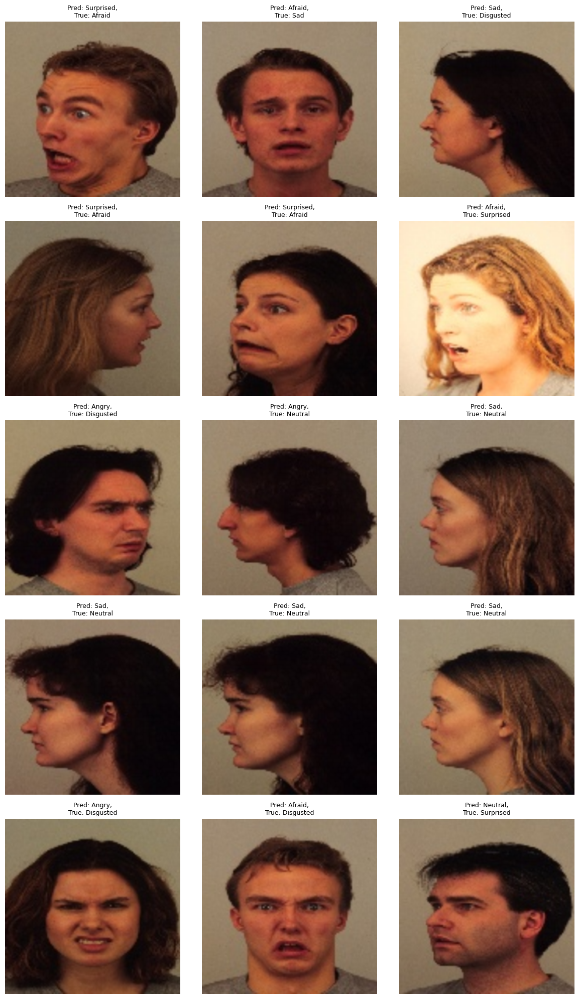




------------------------------------
 Accuracies  [0.9244897959183674, 0.9040816326530613, 0.9020408163265307, 0.9020408163265307, 0.9244897959183674, 0.9122448979591837, 0.916326530612245, 0.9061224489795919]



Epoch 0/19
----------


100%|██████████| 138/138 [00:17<00:00,  7.94it/s]


train Loss: 1.7170 Acc: 0.2971


100%|██████████| 16/16 [00:01<00:00, 14.25it/s]


val Loss: 1.2514 Acc: 0.5367

Epoch 1/19
----------


100%|██████████| 138/138 [00:17<00:00,  7.99it/s]


train Loss: 0.9952 Acc: 0.6156


100%|██████████| 16/16 [00:01<00:00, 13.91it/s]


val Loss: 1.1918 Acc: 0.5388

Epoch 2/19
----------


100%|██████████| 138/138 [00:17<00:00,  7.98it/s]


train Loss: 0.6995 Acc: 0.7351


100%|██████████| 16/16 [00:01<00:00, 14.07it/s]


val Loss: 0.7089 Acc: 0.7449

Epoch 3/19
----------


100%|██████████| 138/138 [00:17<00:00,  7.91it/s]


train Loss: 0.5319 Acc: 0.8052


100%|██████████| 16/16 [00:01<00:00, 13.60it/s]


val Loss: 0.6422 Acc: 0.7551

Epoch 4/19
----------


100%|██████████| 138/138 [00:17<00:00,  8.01it/s]


train Loss: 0.4286 Acc: 0.8481


100%|██████████| 16/16 [00:01<00:00, 13.29it/s]


val Loss: 0.4938 Acc: 0.8265

Epoch 5/19
----------


100%|██████████| 138/138 [00:17<00:00,  7.97it/s]


train Loss: 0.2189 Acc: 0.9252


100%|██████████| 16/16 [00:01<00:00, 13.99it/s]


val Loss: 0.3329 Acc: 0.8714

Epoch 6/19
----------


100%|██████████| 138/138 [00:17<00:00,  7.95it/s]


train Loss: 0.1721 Acc: 0.9435


100%|██████████| 16/16 [00:01<00:00, 13.79it/s]


val Loss: 0.3241 Acc: 0.8796

Epoch 7/19
----------


100%|██████████| 138/138 [00:17<00:00,  7.91it/s]


train Loss: 0.1611 Acc: 0.9490


100%|██████████| 16/16 [00:01<00:00, 13.84it/s]


val Loss: 0.3093 Acc: 0.8837

Epoch 8/19
----------


100%|██████████| 138/138 [00:17<00:00,  8.05it/s]


train Loss: 0.1438 Acc: 0.9494


100%|██████████| 16/16 [00:01<00:00, 14.10it/s]


val Loss: 0.3085 Acc: 0.9020

Epoch 9/19
----------


100%|██████████| 138/138 [00:17<00:00,  8.04it/s]


train Loss: 0.1301 Acc: 0.9562


100%|██████████| 16/16 [00:01<00:00, 14.12it/s]


val Loss: 0.2991 Acc: 0.9020

Epoch 10/19
----------


100%|██████████| 138/138 [00:17<00:00,  7.86it/s]


train Loss: 0.1231 Acc: 0.9596


100%|██████████| 16/16 [00:01<00:00, 14.30it/s]


val Loss: 0.3027 Acc: 0.9041

Epoch 11/19
----------


100%|██████████| 138/138 [00:17<00:00,  8.03it/s]


train Loss: 0.1119 Acc: 0.9655


100%|██████████| 16/16 [00:01<00:00, 13.59it/s]


val Loss: 0.2879 Acc: 0.9061

Epoch 12/19
----------


100%|██████████| 138/138 [00:17<00:00,  8.00it/s]


train Loss: 0.1099 Acc: 0.9685


100%|██████████| 16/16 [00:01<00:00, 14.12it/s]


val Loss: 0.2892 Acc: 0.9061

Epoch 13/19
----------


100%|██████████| 138/138 [00:17<00:00,  7.87it/s]


train Loss: 0.1066 Acc: 0.9662


100%|██████████| 16/16 [00:01<00:00, 14.22it/s]


val Loss: 0.2872 Acc: 0.9082

Epoch 14/19
----------


100%|██████████| 138/138 [00:17<00:00,  8.02it/s]


train Loss: 0.1072 Acc: 0.9671


100%|██████████| 16/16 [00:01<00:00, 12.94it/s]


val Loss: 0.2884 Acc: 0.9020

Epoch 15/19
----------


100%|██████████| 138/138 [00:17<00:00,  7.97it/s]


train Loss: 0.1040 Acc: 0.9689


100%|██████████| 16/16 [00:01<00:00, 13.72it/s]


val Loss: 0.2849 Acc: 0.9082

Epoch 16/19
----------


100%|██████████| 138/138 [00:17<00:00,  8.03it/s]


train Loss: 0.1022 Acc: 0.9689


100%|██████████| 16/16 [00:01<00:00, 13.58it/s]


val Loss: 0.2831 Acc: 0.9082

Epoch 17/19
----------


100%|██████████| 138/138 [00:17<00:00,  8.08it/s]


train Loss: 0.1041 Acc: 0.9673


100%|██████████| 16/16 [00:01<00:00, 13.42it/s]


val Loss: 0.2832 Acc: 0.9061

Epoch 18/19
----------


100%|██████████| 138/138 [00:17<00:00,  8.02it/s]


train Loss: 0.0996 Acc: 0.9703


100%|██████████| 16/16 [00:01<00:00, 14.03it/s]


val Loss: 0.2831 Acc: 0.9082

Epoch 19/19
----------


100%|██████████| 138/138 [00:17<00:00,  8.05it/s]


train Loss: 0.0962 Acc: 0.9717


100%|██████████| 16/16 [00:01<00:00, 13.50it/s]


val Loss: 0.2834 Acc: 0.9122

Training complete in 6m 9s
Best val Acc: 0.912245
Showing misclassified examples for fold 8...


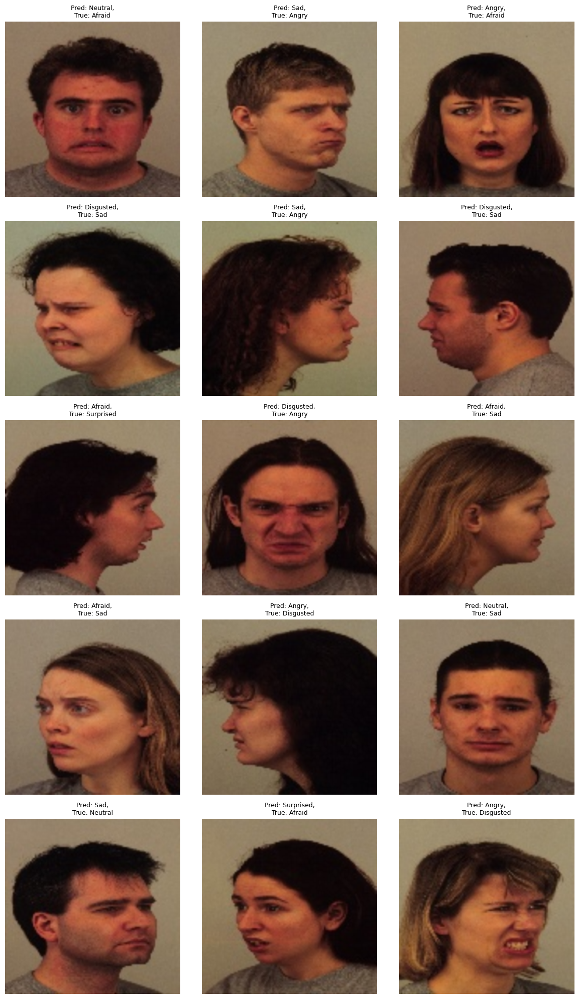




------------------------------------
 Accuracies  [0.9244897959183674, 0.9040816326530613, 0.9020408163265307, 0.9020408163265307, 0.9244897959183674, 0.9122448979591837, 0.916326530612245, 0.9061224489795919, 0.9122448979591837]



Epoch 0/19
----------


100%|██████████| 138/138 [00:17<00:00,  8.02it/s]


train Loss: 1.7713 Acc: 0.2617


100%|██████████| 16/16 [00:01<00:00, 13.26it/s]


val Loss: 1.3604 Acc: 0.4286

Epoch 1/19
----------


100%|██████████| 138/138 [00:17<00:00,  7.99it/s]


train Loss: 1.0843 Acc: 0.5726


100%|██████████| 16/16 [00:01<00:00, 14.09it/s]


val Loss: 0.8509 Acc: 0.7020

Epoch 2/19
----------


100%|██████████| 138/138 [00:17<00:00,  8.02it/s]


train Loss: 0.7275 Acc: 0.7313


100%|██████████| 16/16 [00:01<00:00, 14.26it/s]


val Loss: 0.5123 Acc: 0.7980

Epoch 3/19
----------


100%|██████████| 138/138 [00:17<00:00,  7.95it/s]


train Loss: 0.5529 Acc: 0.7934


100%|██████████| 16/16 [00:01<00:00, 14.09it/s]


val Loss: 0.4058 Acc: 0.8673

Epoch 4/19
----------


100%|██████████| 138/138 [00:17<00:00,  8.02it/s]


train Loss: 0.4053 Acc: 0.8540


100%|██████████| 16/16 [00:01<00:00, 13.88it/s]


val Loss: 0.3095 Acc: 0.8755

Epoch 5/19
----------


100%|██████████| 138/138 [00:17<00:00,  7.97it/s]


train Loss: 0.2156 Acc: 0.9293


100%|██████████| 16/16 [00:01<00:00, 12.87it/s]


val Loss: 0.2256 Acc: 0.9102

Epoch 6/19
----------


100%|██████████| 138/138 [00:17<00:00,  7.98it/s]


train Loss: 0.1853 Acc: 0.9372


100%|██████████| 16/16 [00:01<00:00, 13.90it/s]


val Loss: 0.2162 Acc: 0.9224

Epoch 7/19
----------


100%|██████████| 138/138 [00:17<00:00,  7.99it/s]


train Loss: 0.1651 Acc: 0.9422


100%|██████████| 16/16 [00:01<00:00, 14.03it/s]


val Loss: 0.1984 Acc: 0.9245

Epoch 8/19
----------


100%|██████████| 138/138 [00:17<00:00,  8.00it/s]


train Loss: 0.1511 Acc: 0.9506


100%|██████████| 16/16 [00:01<00:00, 13.57it/s]


val Loss: 0.1919 Acc: 0.9306

Epoch 9/19
----------


100%|██████████| 138/138 [00:17<00:00,  7.97it/s]


train Loss: 0.1343 Acc: 0.9601


100%|██████████| 16/16 [00:01<00:00, 14.13it/s]


val Loss: 0.1891 Acc: 0.9286

Epoch 10/19
----------


100%|██████████| 138/138 [00:17<00:00,  7.98it/s]


train Loss: 0.1217 Acc: 0.9621


100%|██████████| 16/16 [00:01<00:00, 13.27it/s]


val Loss: 0.1835 Acc: 0.9286

Epoch 11/19
----------


100%|██████████| 138/138 [00:17<00:00,  8.04it/s]


train Loss: 0.1143 Acc: 0.9649


100%|██████████| 16/16 [00:01<00:00, 14.20it/s]


val Loss: 0.1808 Acc: 0.9306

Epoch 12/19
----------


100%|██████████| 138/138 [00:17<00:00,  7.99it/s]


train Loss: 0.1063 Acc: 0.9680


100%|██████████| 16/16 [00:01<00:00, 13.78it/s]


val Loss: 0.1815 Acc: 0.9306

Epoch 13/19
----------


100%|██████████| 138/138 [00:17<00:00,  7.94it/s]


train Loss: 0.1036 Acc: 0.9653


100%|██████████| 16/16 [00:01<00:00, 13.88it/s]


val Loss: 0.1813 Acc: 0.9265

Epoch 14/19
----------


100%|██████████| 138/138 [00:17<00:00,  7.97it/s]


train Loss: 0.1028 Acc: 0.9685


100%|██████████| 16/16 [00:01<00:00, 13.98it/s]


val Loss: 0.1811 Acc: 0.9265

Epoch 15/19
----------


100%|██████████| 138/138 [00:17<00:00,  7.92it/s]


train Loss: 0.1003 Acc: 0.9685


100%|██████████| 16/16 [00:01<00:00, 14.15it/s]


val Loss: 0.1816 Acc: 0.9265

Epoch 16/19
----------


100%|██████████| 138/138 [00:17<00:00,  7.95it/s]


train Loss: 0.1016 Acc: 0.9719


100%|██████████| 16/16 [00:01<00:00, 13.96it/s]


val Loss: 0.1779 Acc: 0.9327

Epoch 17/19
----------


100%|██████████| 138/138 [00:17<00:00,  7.91it/s]


train Loss: 0.1000 Acc: 0.9698


100%|██████████| 16/16 [00:01<00:00, 14.07it/s]


val Loss: 0.1778 Acc: 0.9327

Epoch 18/19
----------


100%|██████████| 138/138 [00:17<00:00,  7.89it/s]


train Loss: 0.1044 Acc: 0.9676


100%|██████████| 16/16 [00:01<00:00, 14.05it/s]


val Loss: 0.1778 Acc: 0.9327

Epoch 19/19
----------


100%|██████████| 138/138 [00:17<00:00,  7.86it/s]


train Loss: 0.1002 Acc: 0.9678


100%|██████████| 16/16 [00:01<00:00, 13.72it/s]


val Loss: 0.1779 Acc: 0.9327

Training complete in 6m 10s
Best val Acc: 0.932653
Showing misclassified examples for fold 9...


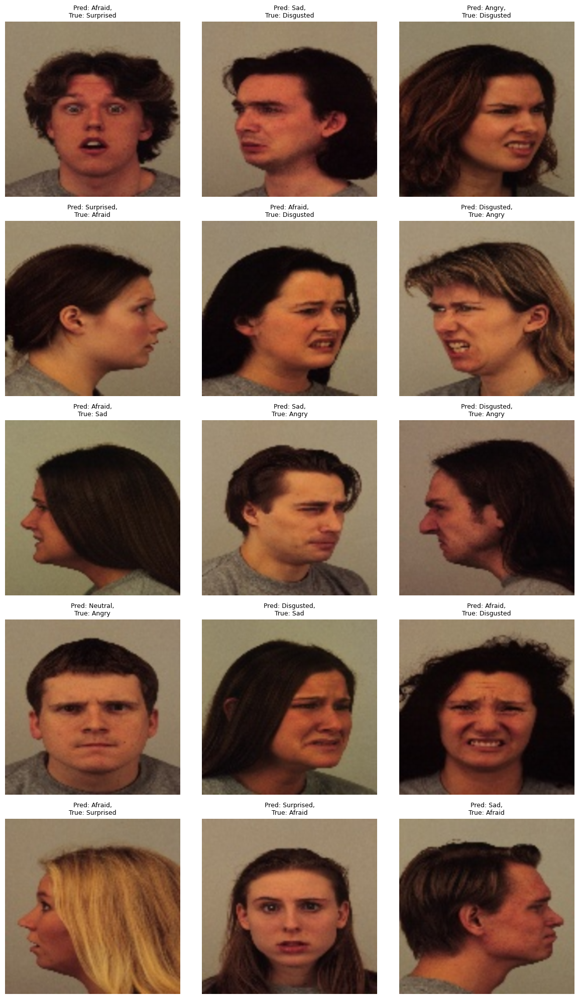




------------------------------------
 Accuracies  [0.9244897959183674, 0.9040816326530613, 0.9020408163265307, 0.9020408163265307, 0.9244897959183674, 0.9122448979591837, 0.916326530612245, 0.9061224489795919, 0.9122448979591837, 0.9326530612244899]





'best_model/VGG19_best_model.pt'

In [11]:
import torch
import os
import numpy as np
import shutil
from torch import nn, optim
from torch.optim import lr_scheduler
from torchvision import models
from torch.utils.tensorboard import SummaryWriter

accuracies = []
index = list(np.random.permutation(4900))

best_overall_acc = 0.0
best_model_path = ""

for i in range(10):
    idx = {
        'val': index[490 * i:490 * (i + 1)],
        'train': index[:i * 490] + index[((i + 1) * 490):]
    }

    dataloaders = {
        x: torch.utils.data.DataLoader(
            KDEFDataset(transforms_=data_transforms[x], idx=idx[x]),
            batch_size=32,
            shuffle=True
        )
        for x in ['train', 'val']
    }

    model_ft = models.vgg19(weights='IMAGENET1K_V1')
    num_ftrs = model_ft.classifier[6].in_features
    model_ft.classifier[6] = nn.Linear(num_ftrs, class_names)
    model_ft = model_ft.to(device)

    criterion = nn.CrossEntropyLoss()
    optimizer_ft = optim.SGD(model_ft.parameters(), lr=0.001, momentum=0.9)
    exp_lr_scheduler = lr_scheduler.StepLR(optimizer_ft, step_size=6, gamma=0.1)

    logdir = f'./logs/VGG-19_kfold_{i}'
    os.makedirs(logdir, exist_ok=True)
    writer = SummaryWriter(logdir)

    os.makedirs('saved', exist_ok=True)

    model_ft, best_acc = train_model(
        model_ft,
        criterion,
        optimizer_ft,
        exp_lr_scheduler,
        dataloaders,
        writer,
        i,
        num_epochs=20
    )

    model_path = f'saved/model_fold_{i}.pt'
    torch.save(model_ft.state_dict(), model_path)

    if best_acc > best_overall_acc:
        best_overall_acc = best_acc
        best_model_path = model_path

    print(f"Showing misclassified examples for fold {i}...")
    visualize_model_misclassified(
        model=model_ft,
        dataloader=dataloaders['val'],
        class_names={
            0: "Afraid", 1: "Angry", 2: "Disgusted",
            3: "Happy", 4: "Neutral", 5: "Sad", 6: "Surprised"
        },
        save_dir=f'misclassified/fold_{i}',
        num_images=15,
    )

    accuracies.append(float(best_acc.cpu().numpy()))
    print("\n\n\n------------------------------------\n Accuracies ", accuracies)
    print("\n\n")


os.makedirs('best_model', exist_ok=True)
shutil.copy(best_model_path, 'best_model/VGG19_best_model.pt')



In [12]:
from google.colab import files

!zip -r VGG19_112x112_logs_best_model.zip logs misclassified best_model
files.download('VGG19_112x112_logs_best_model.zip')

  adding: logs/ (stored 0%)
  adding: logs/VGG-19_kfold_5/ (stored 0%)
  adding: logs/VGG-19_kfold_5/events.out.tfevents.1744970343.a7f1d3f0ea60.1257.5 (deflated 61%)
  adding: logs/VGG-19_kfold_6/ (stored 0%)
  adding: logs/VGG-19_kfold_6/events.out.tfevents.1744970720.a7f1d3f0ea60.1257.6 (deflated 61%)
  adding: logs/VGG-19_kfold_9/ (stored 0%)
  adding: logs/VGG-19_kfold_9/events.out.tfevents.1744971845.a7f1d3f0ea60.1257.9 (deflated 61%)
  adding: logs/VGG-19_kfold_7/ (stored 0%)
  adding: logs/VGG-19_kfold_7/events.out.tfevents.1744971094.a7f1d3f0ea60.1257.7 (deflated 61%)
  adding: logs/VGG-19_kfold_4/ (stored 0%)
  adding: logs/VGG-19_kfold_4/events.out.tfevents.1744969966.a7f1d3f0ea60.1257.4 (deflated 61%)
  adding: logs/VGG-19_kfold_2/ (stored 0%)
  adding: logs/VGG-19_kfold_2/events.out.tfevents.1744969207.a7f1d3f0ea60.1257.2 (deflated 62%)
  adding: logs/VGG-19_kfold_3/ (stored 0%)
  adding: logs/VGG-19_kfold_3/events.out.tfevents.1744969587.a7f1d3f0ea60.1257.3 (deflated 61%)

<IPython.core.display.Javascript object>

<IPython.core.display.Javascript object>